In [1]:
from ultralytics import YOLO
import cv2
from PIL import Image
from IPython.display import display
import numpy as np

In [2]:
# Chose Apple Metal Performance Shaders (MPS) if available, otherwise use CPU
# device = 'mps' if torch.backends.mps.is_available() else 'cpu'

# Use temporary CPU for now. There is some issue with MPS
device = 'cpu'

## Load pretrained YOLOv8 model

In [14]:
model = YOLO('runs/detect/train7/weights/best.pt')

In [15]:
img = cv2.imread('data/images/test/8.jpeg')

In [16]:
results = model(
    img, 
    device=device, 
    conf=0.5,
    imgsz=1280,
)

0: 640x480 300 holds, 967.2ms
Speed: 10.3ms preprocess, 967.2ms inference, 2.4ms postprocess per image at shape (1, 3, 640, 480)


## Get first result

In [6]:
result = results[0]

In [13]:
print(result.names)

{0: 'hold'}


In [7]:
bboxes = np.array(result.boxes.xyxy.cpu(), dtype=int)
classes = np.array(result.boxes.cls.cpu(), dtype=int)

## Draw bounding boxes

In [8]:
color = (0, 255, 0)
thickness = 2

for cls, bbox in zip(classes, bboxes):
    x1, y1, x2, y2 = bbox
    
    cv2.rectangle(img, (x1, y1), (x2, y2), color, thickness)
    
    result_name = result.names[cls]
    cv2.putText(img, result_name, (x1, y1 - 5), cv2.FONT_HERSHEY_PLAIN, 1, color, thickness)

## Draw the preview

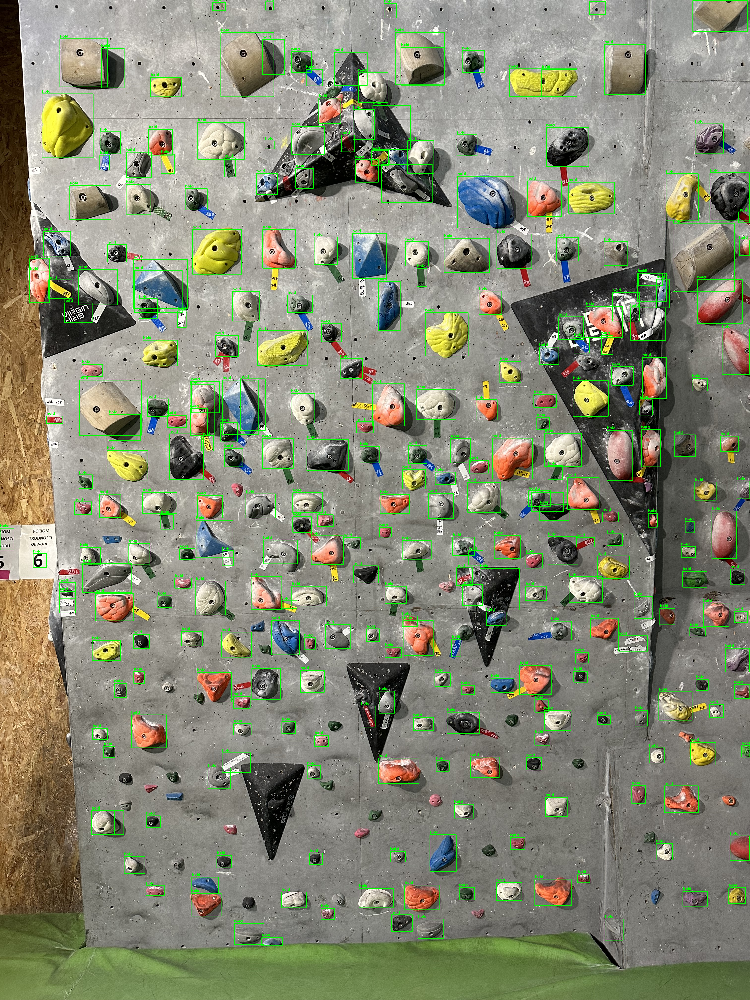

In [9]:
preview = cv2.cvtColor(img, cv2.COLOR_BGR2RGB) # Converting BGR to RGB
display(Image.fromarray(preview))